# Spatial Analysis
This notebook brings in the primary dataset we created in several other notebooks. This includes vaccination rates, vaccine distribution center walkshed coverage, COVID-19 cases, and demographic information for each zip code. 

We conduct a variety of spatial analyses to dive further into the data we assembled. This notebook is far from refined -- we test everything and some things work and others don't. For our final project, we will refine the statistical models, figure out what the tests are telling us, and figure out how the results contribute to the story we are telling.

# Initialize

In [1]:
import pandas as pd
import geopandas as gpd
import contextily as ctx

# autocorrelation
import esda
from esda.moran import Moran, Moran_Local

import splot
from splot.esda import moran_scatterplot, plot_moran, lisa_cluster,plot_moran_simulation

import libpysal as lps

# spatial regression
from pysal.model import spreg
from pysal.lib import weights
from pysal.explore import esda
from scipy import stats
import statsmodels.formula.api as sm
import numpy
import pandas
import geopandas
import matplotlib.pyplot as plt
import seaborn as sns
import libpysal.weights.set_operations as Wsets
from libpysal.weights import Queen, KNN
from sklearn.cluster import KMeans, AgglomerativeClustering
import numpy as np
import matplotlib.pyplot as plt



/opt/conda/lib/python3.8/site-packages/geopandas/_compat.py:106: UserWarning: The Shapely GEOS version (3.8.1-CAPI-1.13.3) is incompatible with the GEOS version PyGEOS was compiled with (3.9.0-CAPI-1.16.2). Conversions between both will be slow.
  warnings.warn(


In [2]:
# import megadataframe
gdf = gpd.read_file('/home/jovyan/206a assigment/Midterm/gdf.geojson')

# High/Low Quartile Analysis

We will create quartiles for our primary variables of interest: percent of vaccine distribution walkshed coverage, percent of population vaccinated, COVID-19 case rate.

In [3]:
# create quartiles 

# walkshed coverage
gdf['irank'] = pd.qcut(gdf['%_iso'], 4, labels=["Q1", "Q2", "Q3", "Q4"])
# vaccination rate
gdf['vrank'] = pd.qcut(gdf['%_partial'], 4, labels=["Q1", "Q2", "Q3", "Q4"])
# covid case rate
gdf['crank'] = pd.qcut(gdf['cases_100k'], 4, labels=["Q1", "Q2", "Q3", "Q4"])


Here we will define a function that assigns "high/low" based on the quartiles for two variables. The inputs are a dataframe containing the quartiles (as created in the previous step), the name of the quartile column, and the name of the each variable to be displayed on the map. This will identify which zip codes have high/low rates of the first variable and high/low rates of the second variable. This will help us identify spatial mismatches between variables. 

In [4]:
# Walkshed Coverage and Partial Vaccination High/Low
def high_low(gdf, var1, var2, name1, name2):
    if gdf[var1] == 'Q4' and gdf[var2] == 'Q4':
        return 'High ' +  name1 + ', High ' + name2
    else:
        if gdf[var1] == 'Q1' and gdf[var2] == 'Q1':
            return 'Low ' +  name1 + ', Low ' + name2
        else:
            if gdf[var1] == 'Q4' and gdf[var2] == 'Q1':
                return 'High ' +  name1 + ', Low ' + name2
            else: 
                if gdf[var1] == 'Q1' and gdf[var2] == 'Q4':
                    return 'Low ' +  name1 + ', High ' + name2

In [5]:
# run function to create the high/low column
gdf['quartile_iso_vac'] = gdf.apply(high_low, args = ('irank', 'vrank', 'Vaccination Site Access', 'Vaccination'), axis=1)
gdf['quartile_vac_cases'] = gdf.apply(high_low, args = ('crank', 'vrank', 'COVID Cases', 'Vaccination'), axis=1)
gdf['quartile_iso_cases'] = gdf.apply(high_low, args = ('irank', 'crank', 'Vaccination Site Access', 'COVID Cases'), axis=1)

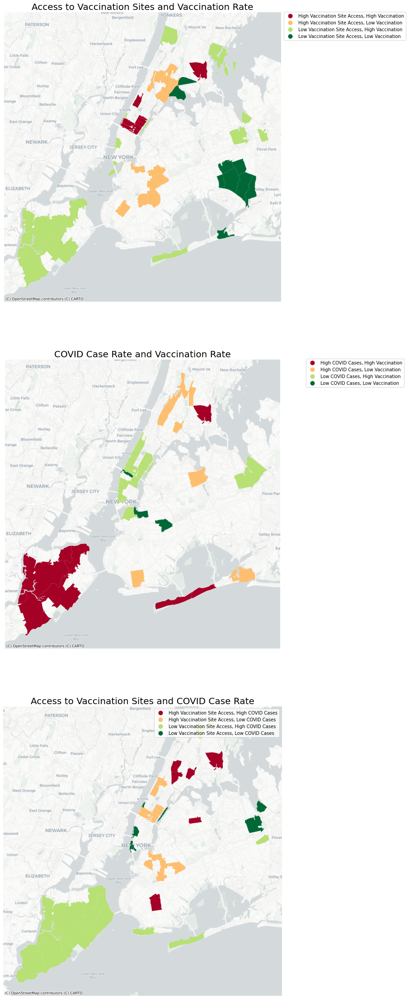

In [6]:
# High/Low Map


fig, ax = plt.subplots(3, 1, figsize=(40,40))
ax1, ax2, ax3= ax

gdf.plot(ax=ax1,
         column= 'quartile_iso_vac',
               legend=True,
              cmap=plt.get_cmap('RdYlGn'))
leg = ax1.get_legend()
leg.set_bbox_to_anchor((1.46,1.01))

gdf.plot(ax=ax2,
         column= 'quartile_vac_cases',
               legend=True,
              cmap=plt.get_cmap('RdYlGn'))
leg = ax2.get_legend()
leg.set_bbox_to_anchor((1.46,1.01))
gdf.plot(ax=ax3,
         column= 'quartile_iso_cases',
               legend=True,
              cmap=plt.get_cmap('RdYlGn'))
leg = ax2.get_legend()
leg.set_bbox_to_anchor((1.46,1.01))

ax1.set_title("Access to Vaccination Sites and Vaccination Rate", fontsize=20)
ax2.set_title("COVID Case Rate and Vaccination Rate", fontsize=20)
ax3.set_title("Access to Vaccination Sites and COVID Case Rate", fontsize=20)


ax1.axis('off')
ax2.axis('off')
ax3.axis('off')

ctx.add_basemap(ax=ax1,source=ctx.providers.CartoDB.Positron)
ctx.add_basemap(ax=ax2,source=ctx.providers.CartoDB.Positron)
ctx.add_basemap(ax=ax3,source=ctx.providers.CartoDB.Positron)

In [7]:
import folium
m = folium.Map()
m = folium.Map([40.7335808, -73.9810874],
                  zoom_start=11,  tiles='cartodbpositron')
style = {'fillOpacity': '0.55', 'opacity': '0'}
m


In [8]:
folium.Choropleth(geo_data=gdf, # geo data
                  data=gdf, # data
                  key_on='feature.properties.zcta', # key, or merge column
                  columns=['zcta','%_iso'], # [key, value]
                  fill_color='BuPu',
                  line_weight=0.1,
                  fill_opacity=0.8,
                  line_opacity=0.2, # line opacity (of the border)
                  legend_name='test').add_to(m)    # name on the legend color bar
m

In [9]:
columns_to_keep=['zcta',
 'geometry',
 'quartile_iso_vac',
 'quartile_vac_cases',
 'quartile_iso_cases']
gdf_quartiles=gdf[columns_to_keep]
gdf_quartiles.head()

,zcta,geometry,quartile_iso_vac,quartile_vac_cases,quartile_iso_cases
0,10001,"POLYGON ((-8238052.420 4975294.641, -8238369.1...",None,None,None
1,10002,"POLYGON ((-8237302.460 4969964.664, -8237321.3...",None,None,None
2,10003,"POLYGON ((-8236758.553 4971957.759, -8236728.8...",None,None,None
3,10004,"MULTIPOLYGON (((-8240609.874 4966094.639, -824...","Low Vaccination Site Access, High Vaccination",None,None
4,10005,"POLYGON ((-8238647.422 4968971.647, -8238753.7...",None,None,"Low Vaccination Site Access, Low COVID Cases"


In [10]:
columns_to_keep=['zcta',
 'geometry',
 'quartile_iso_vac']
gdf_isovacc=gdf[columns_to_keep]
gdf_isovacc=gdf_isovacc.dropna()
gdf_isovacc.head()

,zcta,geometry,quartile_iso_vac
3,10004,"MULTIPOLYGON (((-8240609.874 4966094.639, -824...","Low Vaccination Site Access, High Vaccination"
11,10014,"POLYGON ((-8238025.926 4973884.264, -8237910.0...","Low Vaccination Site Access, High Vaccination"
13,10017,"POLYGON ((-8234142.657 4975158.135, -8234167.3...","High Vaccination Site Access, High Vaccination"
15,10019,"POLYGON ((-8236829.798 4977510.163, -8236903.7...","High Vaccination Site Access, High Vaccination"
16,10021,"MULTIPOLYGON (((-8232189.779 4977839.977, -823...","High Vaccination Site Access, High Vaccination"


In [11]:
import json 

with open("gdf.geojson") as f:
    data = json.load(f)


In [12]:
import plotly.express as px



fig = px.choropleth_mapbox(gdf_isovacc, geojson=data, color='quartile_iso_vac',
                           locations="zcta", featureidkey="properties.zcta",
                           center={"lat": 40.7335808, "lon": -73.9810874},
                           mapbox_style="carto-positron", zoom=11)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()


In [13]:
columns_to_keep=['zcta',
  'geometry',
 ]
gdf_geo=gdf[columns_to_keep]
gdf_geo.head()

,zcta,geometry
0,10001,"POLYGON ((-8238052.420 4975294.641, -8238369.1..."
1,10002,"POLYGON ((-8237302.460 4969964.664, -8237321.3..."
2,10003,"POLYGON ((-8236758.553 4971957.759, -8236728.8..."
3,10004,"MULTIPOLYGON (((-8240609.874 4966094.639, -824..."
4,10005,"POLYGON ((-8238647.422 4968971.647, -8238753.7..."


In [14]:
gdf_test=gdf.rename(columns={'quartile_iso_vac':'Access to Vaccine Site and Vaccination Rate','quartile_vac_cases':'Vaccination Rate and COVID-19 Case Rate','quartile_iso_cases':'Access to Vaccine Site and COVID-19 Case Rate'})
gdf_test.head()

,zcta,%_iso,borough,cases_100k,deaths_100k,%_fully,%_partial,population,%_hispanic,%_white,...,%_foreign,%_lessHS,%_bachelorsbeyond,geometry,irank,vrank,crank,Access to Vaccine Site and Vaccination Rate,Vaccination Rate and COVID-19 Case Rate,Access to Vaccine Site and COVID-19 Case Rate
0,10001,74.989601,Manhattan,4483.38,112.27,10.0,23.0,"25,537",15.511880,54.579757,...,29.390057,9.206383,68.250052,"POLYGON ((-8238052.420 4975294.641, -8238369.1...",Q3,Q3,Q1,None,None,None
1,10002,47.395030,Manhattan,6441.62,305.35,10.0,24.0,"63,973",26.254380,22.014259,...,42.052122,33.705726,33.385569,"POLYGON ((-8237302.460 4969964.664, -8237321.3...",Q2,Q3,Q2,None,None,None
2,10003,81.263538,Manhattan,4170.23,79.66,12.0,24.0,"50,399",8.446190,69.133149,...,20.115975,4.446028,79.516610,"POLYGON ((-8236758.553 4971957.759, -8236728.8...",Q3,Q3,Q1,None,None,None
3,10004,0.282911,Manhattan,7334.84,67.29,14.0,31.0,"2,685",3.238381,59.280360,...,23.268366,1.057455,91.857596,"MULTIPOLYGON (((-8240609.874 4966094.639, -824...",Q1,Q4,Q2,"Low Vaccination Site Access, High Vaccination",None,None
4,10005,23.923138,Manhattan,3756.90,0.00,8.0,18.0,"8,170",6.344098,71.669923,...,18.584071,0.232594,90.324081,"POLYGON ((-8238647.422 4968971.647, -8238753.7...",Q1,Q2,Q1,None,None,"Low Vaccination Site Access, Low COVID Cases"


In [15]:
from ipywidgets import interact
from ipywidgets.embed import embed_minimal_html

quartile=[ 'Access to Vaccine Site and Vaccination Rate',
 'Vaccination Rate and COVID-19 Case Rate',
 'Access to Vaccine Site and COVID-19 Case Rate']


@interact

def quantile_map(Map=quartile):
    fig= gdf_test.plot(
         column= Map,
               legend=True,
              cmap=plt.get_cmap('RdYlGn'),figsize=(10,20))
    fig.set_title(Map, fontsize=20)
    fig.axis('off')
    leg = fig.get_legend()
    leg.set_bbox_to_anchor((1.4,1.01))
    ctx.add_basemap(fig,source=ctx.providers.CartoDB.Positron)



interactive(children=(Dropdown(description='Map', options=('Access to Vaccine Site and Vaccination Rate', 'Vac…

Next, we will look at the demographics of each "high/low" category to identify explanatory variables in the spatial mismatch. We will look at the median value for each demographic variable.

In [16]:
column_means = ['%_hispanic', '%_white', '%_black', '%_asian', '%_disability', 
    '%_over65', '%_poverty', '%_foreign', '%_lessHS','%_bachelorsbeyond']
median_quart_isovac= gdf.groupby('quartile_iso_vac', as_index=False)[column_means].median()
median_quart_isovac

,quartile_iso_vac,%_hispanic,%_white,%_black,%_asian,%_disability,%_over65,%_poverty,%_foreign,%_lessHS,%_bachelorsbeyond
0,"High Vaccination Site Access, High Vaccination",15.598598,69.506500,3.168255,11.738780,12.012019,21.016574,6.487442,26.676254,4.697083,76.794052
1,"High Vaccination Site Access, Low Vaccination",32.526747,6.343793,36.561796,1.720444,14.382135,10.172202,27.670268,32.990980,21.822186,24.500306
2,"Low Vaccination Site Access, High Vaccination",12.253403,58.544827,3.037570,11.956031,11.603111,18.007876,7.249054,23.739576,8.422631,48.536793
3,"Low Vaccination Site Access, Low Vaccination",14.686701,1.721709,62.413225,3.110226,12.631447,13.137628,11.244622,38.249201,17.770245,21.582766


In [17]:
median_quart_vaccases= gdf.groupby('quartile_vac_cases', as_index=False)[column_means].median()
median_quart_vaccases

,quartile_vac_cases,%_hispanic,%_white,%_black,%_asian,%_disability,%_over65,%_poverty,%_foreign,%_lessHS,%_bachelorsbeyond
0,"High COVID Cases, High Vaccination",15.427432,67.248291,4.488949,5.991090,12.996046,17.629518,10.215963,23.456673,10.584854,35.798466
1,"High COVID Cases, Low Vaccination",68.989924,3.336185,26.145671,2.702607,15.203214,10.106321,27.473105,42.643045,32.028332,14.927109
2,"Low COVID Cases, High Vaccination",10.822484,66.799298,3.189063,12.191730,10.903271,18.737780,7.396167,24.750929,3.850017,79.596765
3,"Low COVID Cases, Low Vaccination",16.068590,44.286233,28.439681,6.331789,10.054156,7.256416,27.144034,23.416710,16.640925,45.580259


In [18]:
median_quart_isocases= gdf.groupby('quartile_iso_cases', as_index=False)[column_means].median()
median_quart_isocases

,quartile_iso_cases,%_hispanic,%_white,%_black,%_asian,%_disability,%_over65,%_poverty,%_foreign,%_lessHS,%_bachelorsbeyond
0,"High Vaccination Site Access, High COVID Cases",59.077974,10.437430,16.664569,6.646706,15.514144,14.038722,26.734811,37.012909,26.783031,23.977115
1,"High Vaccination Site Access, Low COVID Cases",15.424647,52.635463,8.091676,8.959878,11.492332,14.201358,13.763001,24.752529,8.276990,70.771064
2,"Low Vaccination Site Access, High COVID Cases",15.592925,62.434293,3.190707,6.293103,12.061307,16.914419,9.127803,23.780092,10.368858,35.583800
3,"Low Vaccination Site Access, Low COVID Cases",10.834411,64.521345,2.412824,19.885872,7.188894,9.962089,6.962921,31.102029,1.483942,85.189601


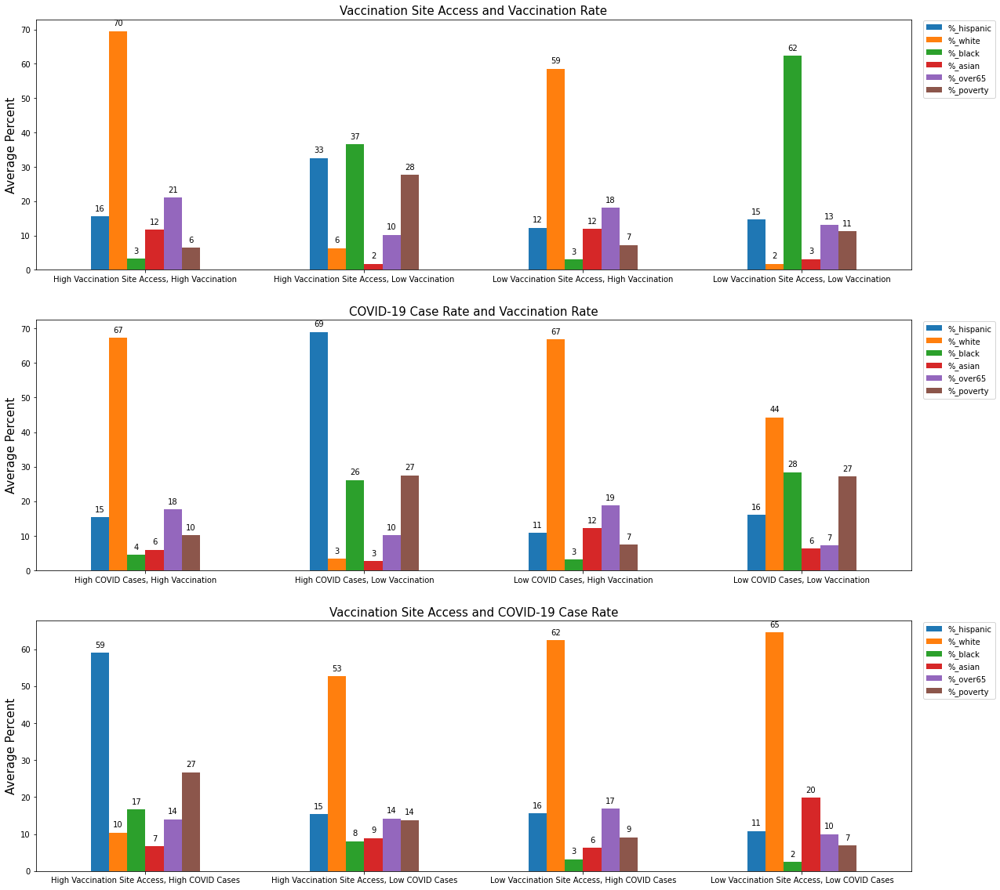

In [19]:

fig, axs = plt.subplots(3,1, figsize=(20,20))

ax1, ax2, ax3 = axs
                        
median_quart_isovac.reset_index().plot( ax=ax1, 
    x="quartile_iso_vac", y=['%_hispanic',
 '%_white',
 '%_black',
 '%_asian', '%_over65', '%_poverty'], kind="bar")
ax1.set_title("Vaccination Site Access and Vaccination Rate", fontsize=15)
ax1.set_ylabel("Average Percent", fontsize=15)
ax1.set_xlabel("", fontsize=15)
ax1.set_xticklabels(ax1.get_xticklabels(), rotation=0)


median_quart_vaccases.reset_index().plot( ax=ax2, 
    x="quartile_vac_cases", y=['%_hispanic',
 '%_white',
 '%_black',
 '%_asian', '%_over65', '%_poverty'], kind="bar")
ax2.set_title("COVID-19 Case Rate and Vaccination Rate", fontsize=15)
ax2.set_ylabel("Average Percent", fontsize=15)
ax2.set_xlabel("", fontsize=15)
ax2.set_xticklabels(ax2.get_xticklabels(), rotation=0)


median_quart_isocases.reset_index().plot(ax=ax3, 
    x="quartile_iso_cases", y=['%_hispanic',
 '%_white',
 '%_black',
 '%_asian', '%_over65',  '%_poverty'], kind="bar")
ax3.set_title("Vaccination Site Access and COVID-19 Case Rate", fontsize=15)
ax3.set_ylabel("Average Percent", fontsize=15)
ax3.set_xlabel("", fontsize=15)
ax3.set_xticklabels(ax3.get_xticklabels(), rotation=0)

def add_value_labels(ax1, spacing=5):
    # For each bar: Place a label
    for rect in ax1.patches:
        # Get X and Y placement of label from rect.
        y = rect.get_height()
        x = rect.get_x() + rect.get_width() / 2

        # Number of points between bar and label. Change to your liking.
        space = spacing
        # Vertical alignment for positive values
        va = 'bottom'

        # If value of bar is negative: Place label below bar
        if y < 0:
            # Invert space to place label below
            space *= -1
            # Vertically align label at top
            va = 'top'

        # Use Y value as label and format number with one decimal place
        label = "{:.0f}".format(y)

        # Create annotation
        ax1.annotate(
            label,                      # Use `label` as label
            (x, y),         # Place label at end of the bar
            xytext=(0, space),          # Vertically shift label by `space`
            textcoords="offset points", # Interpret `xytext` as offset in points
            ha='center',                # Horizontally center label
            va=va)                      # Vertically align label differently for
                                        # positive and negative values.


# Call the function above. All the magic happens there.
add_value_labels(ax1)
leg = ax1.get_legend()
leg.set_bbox_to_anchor((1.1,1.01))


def add_value_labels(ax2, spacing=5):
    # For each bar: Place a label
    for rect in ax2.patches:
        # Get X and Y placement of label from rect.
        y = rect.get_height()
        x = rect.get_x() + rect.get_width() / 2

        # Number of points between bar and label. Change to your liking.
        space = spacing
        # Vertical alignment for positive values
        va = 'bottom'

        # If value of bar is negative: Place label below bar
        if y < 0:
            # Invert space to place label below
            space *= -1
            # Vertically align label at top
            va = 'top'

        # Use Y value as label and format number with one decimal place
        label = "{:.0f}".format(y)

        # Create annotation
        ax2.annotate(
            label,                      # Use `label` as label
            (x, y),         # Place label at end of the bar
            xytext=(0, space),          # Vertically shift label by `space`
            textcoords="offset points", # Interpret `xytext` as offset in points
            ha='center',                # Horizontally center label
            va=va)                      # Vertically align label differently for
                                        # positive and negative values.


# Call the function above. All the magic happens there.
add_value_labels(ax2)
leg = ax2.get_legend()
leg.set_bbox_to_anchor((1.1,1.01))

def add_value_labels(ax3, spacing=5):
    # For each bar: Place a label
    for rect in ax3.patches:
        # Get X and Y placement of label from rect.
        y = rect.get_height()
        x = rect.get_x() + rect.get_width() / 2

        # Number of points between bar and label. Change to your liking.
        space = spacing
        # Vertical alignment for positive values
        va = 'bottom'

        # If value of bar is negative: Place label below bar
        if y < 0:
            # Invert space to place label below
            space *= -1
            # Vertically align label at top
            va = 'top'

        # Use Y value as label and format number with one decimal place
        label = "{:.0f}".format(y)

        # Create annotation
        ax3.annotate(
            label,                      # Use `label` as label
            (x, y),         # Place label at end of the bar
            xytext=(0, space),          # Vertically shift label by `space`
            textcoords="offset points", # Interpret `xytext` as offset in points
            ha='center',                # Horizontally center label
            va=va)                      # Vertically align label differently for
                                        # positive and negative values.


# Call the function above. All the magic happens there.
add_value_labels(ax3)
leg = ax3.get_legend()
leg.set_bbox_to_anchor((1.1,1.01))


This high/low analysis is really valuable. We can see spatially the mismatch between vaccine access and vaccination rates and then dive in further to the demographics. 

# Spatial Autocorrelation
In this section, we'll look at the spatial autocorrelation of vaccination rates in order to identify clustering. While interesting, this analysis is of less use to us because it doesn't correlate with other explanatory variables. I would like to know how to extract values from the Moran Local Scatterplot to know which zip codes are falling into the high/low categories.

In [20]:
gdf['case_vacc_rate']= gdf['cases_100k']/gdf['%_partial']
gdf['iso_vacc_rate']=gdf['%_iso']/gdf['%_partial']


gdf.head()

,zcta,%_iso,borough,cases_100k,deaths_100k,%_fully,%_partial,population,%_hispanic,%_white,...,%_bachelorsbeyond,geometry,irank,vrank,crank,quartile_iso_vac,quartile_vac_cases,quartile_iso_cases,case_vacc_rate,iso_vacc_rate
0,10001,74.989601,Manhattan,4483.38,112.27,10.0,23.0,"25,537",15.511880,54.579757,...,68.250052,"POLYGON ((-8238052.420 4975294.641, -8238369.1...",Q3,Q3,Q1,None,None,None,194.929565,3.260417
1,10002,47.395030,Manhattan,6441.62,305.35,10.0,24.0,"63,973",26.254380,22.014259,...,33.385569,"POLYGON ((-8237302.460 4969964.664, -8237321.3...",Q2,Q3,Q2,None,None,None,268.400833,1.974793
2,10003,81.263538,Manhattan,4170.23,79.66,12.0,24.0,"50,399",8.446190,69.133149,...,79.516610,"POLYGON ((-8236758.553 4971957.759, -8236728.8...",Q3,Q3,Q1,None,None,None,173.759583,3.385981
3,10004,0.282911,Manhattan,7334.84,67.29,14.0,31.0,"2,685",3.238381,59.280360,...,91.857596,"MULTIPOLYGON (((-8240609.874 4966094.639, -824...",Q1,Q4,Q2,"Low Vaccination Site Access, High Vaccination",None,None,236.607742,0.009126
4,10005,23.923138,Manhattan,3756.90,0.00,8.0,18.0,"8,170",6.344098,71.669923,...,90.324081,"POLYGON ((-8238647.422 4968971.647, -8238753.7...",Q1,Q2,Q1,None,None,"Low Vaccination Site Access, Low COVID Cases",208.716667,1.329063


## Global Autocorrelation

In [21]:
# calculate spatial weight
wq =  lps.weights.KNN.from_dataframe(gdf,k=8)

# Row-standardization
wq.transform = 'r'

In [22]:
# create a new column for the spatial lag
gdf['partial_lag'] = lps.weights.lag_spatial(wq, gdf['%_partial'])
gdf['case_vacc_rate_lag'] = lps.weights.lag_spatial(wq, gdf['case_vacc_rate'])
gdf['iso_vacc_rate_lag'] = lps.weights.lag_spatial(wq, gdf['iso_vacc_rate'])

In [23]:
gdf.iso_vacc_rate.describe()

count    177.000000
mean       2.917260
std        2.004079
min        0.000000
25%        1.267644
50%        2.626933
75%        4.582554
max        8.149378
Name: iso_vacc_rate, dtype: float64

In [24]:
gdf.case_vacc_rate.describe()

count    177.000000
mean     373.453608
std      157.678313
min      100.643415
25%      243.316071
50%      372.826364
75%      482.188667
max      824.007273
Name: case_vacc_rate, dtype: float64

In [25]:
# generate the Moran statistic
y = gdf['%_partial']
moran = Moran(y, wq)

print(moran.I)

0.4523091241591014


In [26]:
y1 = gdf['case_vacc_rate_lag']
moran1 = Moran(y1, wq)

print(moran1.I)

0.9135982953001673


In [27]:
y2 = gdf['iso_vacc_rate_lag']
moran2 = Moran(y2, wq)

print(moran2.I)

0.8824625376878923


In [28]:
x= gdf['cases_100k']
y1=gdf['%_partial']

In [29]:
# calculate p-value
print(moran2.p_sim)

0.001


## Local Autocorrelation

In [30]:
# calculate local moran values
lisa = esda.moran.Moran_Local(y, wq)
lisa1 = esda.moran.Moran_Local(y1, wq)
lisa2 = esda.moran.Moran_Local(y2, wq)

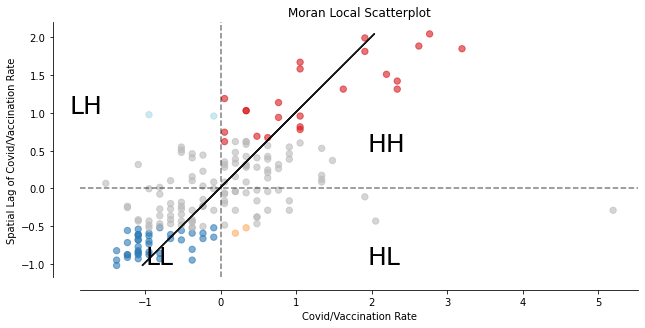

In [31]:
# Plot
fig,ax = plt.subplots(figsize=(10,15))

moran_scatterplot(lisa1, ax=ax, p=0.05)

ax.set_xlabel("Covid/Vaccination Rate")
ax.set_ylabel('Spatial Lag of Covid/Vaccination Rate')

# add some labels
plt.text(1.95, 0.5, "HH", fontsize=25)
plt.text(1.95, -1, "HL", fontsize=25)
plt.text(-2, 1, "LH", fontsize=25)
plt.text(-1, -1, "LL", fontsize=25)
plt.show()

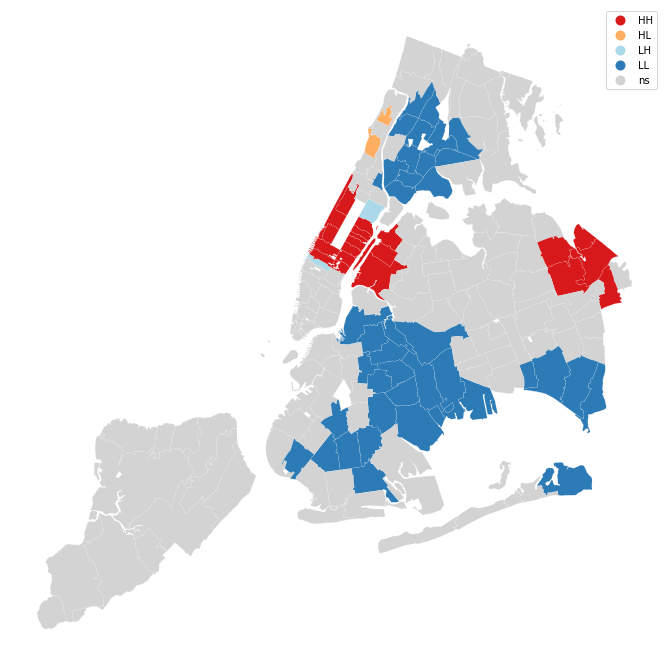

In [32]:
fig, ax = plt.subplots(figsize=(14,12))
lisa_cluster(lisa1, gdf, p=0.05, ax=ax)
plt.show()

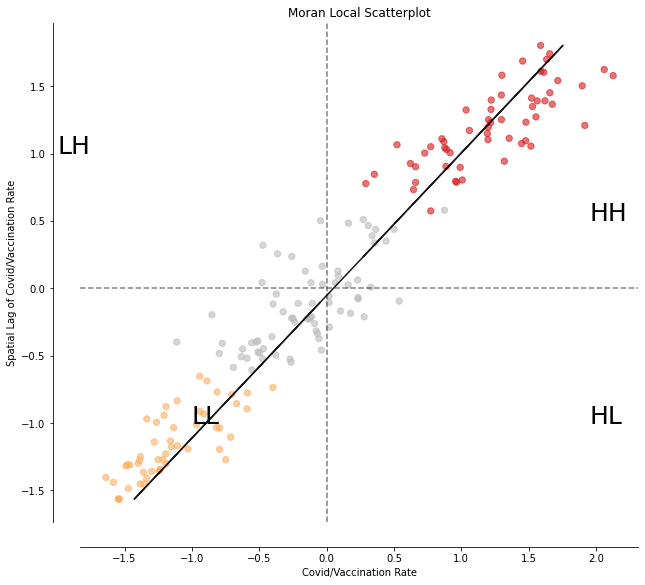

In [33]:
# Plot
fig,ax = plt.subplots(figsize=(10,15))

moran_scatterplot(lisa2, ax=ax, p=0.05)

ax.set_xlabel("Covid/Vaccination Rate")
ax.set_ylabel('Spatial Lag of Covid/Vaccination Rate')

# add some labels
plt.text(1.95, 0.5, "HH", fontsize=25)
plt.text(1.95, -1, "HL", fontsize=25)
plt.text(-2, 1, "LH", fontsize=25)
plt.text(-1, -1, "LL", fontsize=25)
plt.show()

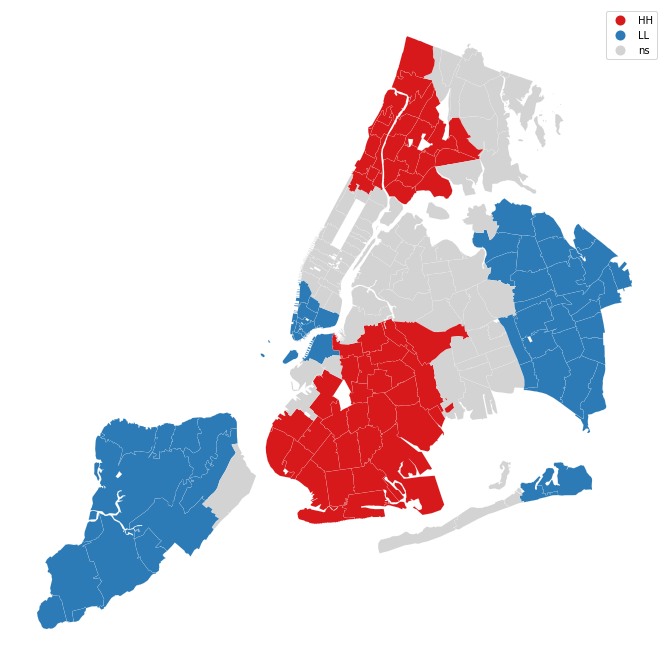

In [34]:
fig, ax = plt.subplots(figsize=(14,12))
lisa_cluster(lisa2, gdf, p=0.05, ax=ax)
plt.show()

look at p-value outputs and then get the cut-offs. lisa has different arguments that allow you to extract the values.  you have to specifically identify and output a dataframe. 

# Spatial Regression
The following workflow is taken from [Geographic Data Science for Python: Spatial Regression](https://geographicdata.science/book/notebooks/11_regression.html). Spatial regression doesn't seem to be the best analysis tool for our dataset -- I think it is better suited for point data with a larger number of observations. However, the results of the multivariate regression are interesting, and we could further refine the model in the future.

## Spatial Regression with COVID data

In [35]:
# store explanatory variable names in a list
variable_names = ['cases_100k',  '%_iso']

In [36]:
# non-spatial multivariate regression
m1 = spreg.OLS(gdf['%_partial'].values, gdf[variable_names].values,
                name_y='%_partial', name_x=variable_names)


print(m1.summary)

REGRESSION
----------
SUMMARY OF OUTPUT: ORDINARY LEAST SQUARES
-----------------------------------------
Data set            :     unknown
Weights matrix      :        None
Dependent Variable  :   %_partial                Number of Observations:         177
Mean dependent var  :     21.6497                Number of Variables   :           3
S.D. dependent var  :      7.0107                Degrees of Freedom    :         174
R-squared           :      0.0601
Adjusted R-squared  :      0.0493
Sum squared residual:    8130.103                F-statistic           :      5.5664
Sigma-square        :      46.725                Prob(F-statistic)     :    0.004537
S.E. of regression  :       6.836                Log likelihood        :    -589.857
Sigma-square ML     :      45.933                Akaike info criterion :    1185.715
S.E of regression ML:      6.7774                Schwarz criterion     :    1195.243

-----------------------------------------------------------------------------

NameError: name 'seaborn' is not defined

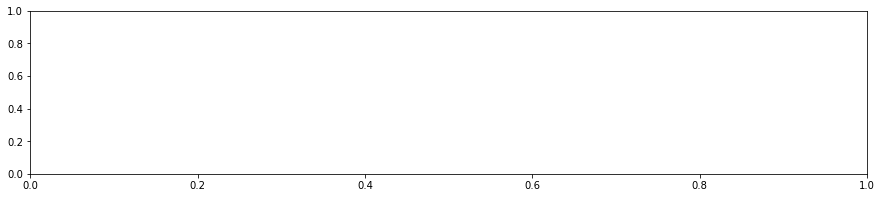

In [37]:
# make box plot of median residuals by neighborhood

gdf['residual'] = m1.u
medians = gdf.groupby("borough").residual.median().to_frame('borough_residual')

f = plt.figure(figsize=(15,3))
ax = plt.gca()
seaborn.boxplot('borough', 'residual', ax = ax,
                data=gdf.merge(medians, how='left',
                              left_on='borough',
                              right_index=True)
                   .sort_values('borough_residual'), palette='bwr')
f.autofmt_xdate()
plt.show()

In [ ]:
# calculate spatial weight and spatial lag and scatter plot

knn = weights.KNN.from_dataframe(gdf, k=1)

lag_residual = weights.spatial_lag.lag_spatial(knn, m1.u)
ax = seaborn.regplot(m1.u.flatten(), lag_residual.flatten(), 
                     line_kws=dict(color='orangered'),
                     ci=None)
ax.set_xlabel('Model Residuals - $u$')
ax.set_ylabel('Spatial Lag of Model Residuals - $W u$');



In [ ]:
# do with more neighbors and plot

knn.reweight(k=4, inplace=True)
outliers = esda.moran.Moran_Local(m1.u, knn, permutations=9999)
error_clusters = (outliers.q % 2 == 1) # only the cluster cores
error_clusters &= (outliers.p_sim <= .001) # filtering out non-significant clusters
gdf.assign(error_clusters = error_clusters,
          local_I = outliers.Is)\
  .query("error_clusters")\
  .sort_values('local_I')\
  .plot('local_I', cmap='bwr', marker='.');



## Correlations Between Variable

## Spatial Regression with Race

In [ ]:
#explonatory variable stored -- adding race into the analysis 
variable_names_2 = ['cases_100k',  '%_iso','%_hispanic', '%_black',
 '%_asian']

In [ ]:
m2 = spreg.OLS(gdf['%_partial'].values, gdf[variable_names_2].values,
                name_y='%_partial', name_x=variable_names_2)


print(m2.summary)

In [ ]:
# make box plot of median residuals by neighborhood

gdf['residual_2'] = m2.u
medians = gdf.groupby("borough").residual_2.median().to_frame('borough_residual')

f = plt.figure(figsize=(15,3))
ax = plt.gca()
seaborn.boxplot('borough', 'residual_2', ax = ax,
                data=gdf.merge(medians, how='left',
                              left_on='borough',
                              right_index=True)
                   .sort_values('borough_residual'), palette='bwr')
f.autofmt_xdate()
plt.show()

In [ ]:
# calculate spatial weight and spatial lag and scatter plot

knn_2 = weights.KNN.from_dataframe(gdf, k=1)

lag_residual = weights.spatial_lag.lag_spatial(knn_2, m2.u)
ax = seaborn.regplot(m2.u.flatten(), lag_residual.flatten(), 
                     line_kws=dict(color='orangered'),
                     ci=None)
ax.set_xlabel('Model Residuals - $u$')
ax.set_ylabel('Spatial Lag of Model Residuals - $W u$');



In [ ]:
# do with more neighbors and plot

knn_2.reweight(k=4, inplace=True)
outliers = esda.moran.Moran_Local(m2.u, knn, permutations=9999)
error_clusters = (outliers.q % 2 == 1) # only the cluster cores
error_clusters &= (outliers.p_sim <= .001) # filtering out non-significant clusters
gdf.assign(error_clusters = error_clusters,
          local_I = outliers.Is)\
  .query("error_clusters")\
  .sort_values('local_I')\
  .plot('local_I', cmap='bwr', marker='.');


## Spatial Regression with Other Demographic Data

In [ ]:
# including people over 65, living in poverty, foreign born, no high school education
variable_names_3 = ['cases_100k', '%_iso', '%_hispanic',
 '%_black',
 '%_asian',
 '%_over65']

In [ ]:
m3 = spreg.OLS(gdf['%_partial'].values, gdf[variable_names_3].values,
                name_y='%_partial', name_x=variable_names_3)


print(m3.summary)

In [ ]:
# make box plot of median residuals by neighborhood

gdf['residual_3'] = m3.u
medians = gdf.groupby("borough").residual_3.median().to_frame('borough_residual')

f = plt.figure(figsize=(15,3))
ax = plt.gca()
seaborn.boxplot('borough', 'residual_3', ax = ax,
                data=gdf.merge(medians, how='left',
                              left_on='borough',
                              right_index=True)
                   .sort_values('borough_residual'), palette='bwr')
f.autofmt_xdate()
plt.show()

In [ ]:
# calculate spatial weight and spatial lag and scatter plot

knn_3 = weights.KNN.from_dataframe(gdf, k=1)

lag_residual = weights.spatial_lag.lag_spatial(knn_3, m3.u)
ax = seaborn.regplot(m3.u.flatten(), lag_residual.flatten(), 
                     line_kws=dict(color='orangered'),
                     ci=None)
ax.set_xlabel('Model Residuals - $u$')
ax.set_ylabel('Spatial Lag of Model Residuals - $W u$');



In [ ]:
# do with more neighbors and plot

knn_3.reweight(k=4, inplace=True)
outliers = esda.moran.Moran_Local(m3.u, knn_3, permutations=9999)
error_clusters = (outliers.q % 2 == 1) # only the cluster cores
error_clusters &= (outliers.p_sim <= .001) # filtering out non-significant clusters
gdf.assign(error_clusters = error_clusters,
          local_I = outliers.Is)\
  .query("error_clusters")\
  .sort_values('local_I')\
  .plot('local_I', cmap='bwr', marker='.');



# Evaluating Variables 
This workflow is from [Geographic Data Science with Python: Clustering and Regionalization.](https://geographicdata.science/book/notebooks/10_clustering_and_regionalization.html) This analysis looks far more promising and works better with our dataset. Since we have so many different variables, this is a good way to visualize all of them and figure out which ones are most relevant to our analysis. 

In [ ]:
# choose variables for clustering effects
cluster_variables =  ['%_partial', 'cases_100k',  '%_iso', '%_hispanic', '%_black', '%_asian','%_over65', '%_disability','%_poverty', '%_foreign', '%_lessHS']

#cluster_variables =  ['%_partial','cases_100k']

In [ ]:
f, axs = plt.subplots(nrows=4, ncols=3, figsize=(12, 12))
# Make the axes accessible with single indexing
axs = axs.flatten()
# Start a loop over all the variables of interest
for i, col in enumerate(cluster_variables):
    # select the axis where the map will go
    ax = axs[i]
    # Plot the map
    gdf.plot(column=col, ax=ax, scheme='Quantiles', 
            linewidth=0, cmap='RdPu')
    # Remove axis clutter
    ax.set_axis_off()
    # Set the axis title to the name of variable being plotted
    ax.set_title(col)
# Display the figure
plt.show()

In [ ]:
# check for islands
w = Queen.from_dataframe(gdf)
w.islands
# It's Roosevelt Island}

In [ ]:
# conduct spatial autocorrelation on all variables


# Set seed for reproducibility
numpy.random.seed(123456)
# Calculate Moran's I for each variable
mi_results = [Moran(gdf[variable], w) for variable in cluster_variables]
# Display on table
table = pandas.DataFrame([(variable, res.I, res.p_sim) \
                          for variable,res \
                          in zip(cluster_variables, mi_results)
                         ], columns=['Variable', "Moran's I", 'P-value']
                        )\
              .set_index('Variable')
table

In [ ]:
# create scatterplots of each combo of variables
# the diagonal shows density plot for each variable

_ = seaborn.pairplot(gdf[cluster_variables], kind='reg', diag_kind='kde')


We are most interested in the scatterplots of between vaccination rates and other explantory variables. So the first two columns are of most interest to us, to identify which variables correlate strongly with vaccination rates. 

## K-Means Clustering

This method clusters observations by means. I chose k=5, but that could be changed.

In [ ]:
# Initialise KMeans instance
kmeans = KMeans(n_clusters=5)

In [ ]:
# Set the seed for reproducibility
numpy.random.seed(1234)
# Run K-Means algorithm
k5cls = kmeans.fit(gdf[cluster_variables])

In [ ]:
k5cls.labels_

In [ ]:
# Plot the clustering

# Assign labels into a column
gdf['k5cls'] = k5cls.labels_
# Setup figure and ax
f, ax = plt.subplots(1, figsize=(9, 9))
# Plot unique values choropleth including a legend and with no boundary lines
gdf.plot(column='k5cls', categorical=True, legend=True, linewidth=0, ax=ax)
# Remove axis
ax.set_axis_off()
# Keep axes proportionate
plt.axis('equal')
# Add title
plt.title(r'Geodemographic Clusters (k-means, $k=5$)')
# Display the map
plt.show()

These clusters are kind of disjointed and might not be the most descriptive.

In [ ]:
# Group data table by cluster label and count observations
k5sizes = gdf.groupby('k5cls').size()
k5sizes

In [ ]:
# bar graph of the clusters
_ = k5sizes.plot.bar()

In [ ]:
# Dissolve areas by Cluster, aggregate by summing, and keep column for area
gdf ['zarea'] = gdf.area
areas = gdf.dissolve(by='k5cls', aggfunc='sum')['zarea']
areas

In [ ]:
# Group table by cluster label, keep the variables used 
# for clustering, and obtain their mean
k5means = gdf.groupby('k5cls')[cluster_variables].mean()
k5means.T.round(3)

In [ ]:
# Group table by cluster label, keep the variables used 
# for clustering, and obtain their descriptive summary
k5desc = gdf.groupby('k5cls')[cluster_variables].describe()
# Loop over each cluster and print a table with descriptives
for cluster in k5desc.T:
    print('\n\t---------\n\tCluster %i'%cluster)
    print(k5desc.T[cluster].unstack())

In [ ]:
# Index db on cluster ID
tidy_gdf = gdf.set_index('k5cls')
# Keep only variables used for clustering
tidy_gdf = tidy_gdf[cluster_variables]
# Stack column names into a column, obtaining 
# a "long" version of the dataset
tidy_gdf = tidy_gdf.stack()
# Take indices into proper columns
tidy_gdf = tidy_gdf.reset_index()
# Rename column names
tidy_gdf = tidy_gdf.rename(columns={
                        'level_1': 'Attribute', 
                        0: 'Values'})
# Check out result
tidy_gdf.head()

In [ ]:
# Setup the facets
facets = seaborn.FacetGrid(data=tidy_gdf, col='Attribute', hue='k5cls', \
                  sharey=False, sharex=False, aspect=2, col_wrap=3)
# Build the plot from `sns.kdeplot`
_ = facets.map(seaborn.kdeplot, 'Values', shade=True).add_legend()

This is a useful way of looking at the distribution of each variable by cluster. This can help us better understand how our variables are spatially distributed. 

## Hierarchical Clustering
This is a different method that uses agglomerative hierarchical clustering. Let's see how the results vary from k-means.

In [ ]:
# Set seed for reproducibility
numpy.random.seed(0)
# Iniciate the algorithm
model = AgglomerativeClustering(linkage='ward', n_clusters=5)
# Run clustering
model.fit(gdf[cluster_variables])
# Assign labels to main data table
gdf['ward5'] =model.labels_

In [ ]:
# check size of clusters
ward5sizes = gdf.groupby('ward5').size()
ward5sizes

In [ ]:
# check simple averages of clusters
ward5means = gdf.groupby('ward5')[cluster_variables].mean()
ward5means.T.round(3)

In [ ]:
# Index db on cluster ID
tidy_gdf = gdf.set_index('ward5')
# Keep only variables used for clustering
tidy_gdf = tidy_gdf[cluster_variables]
# Stack column names into a column, obtaining 
# a "long" version of the dataset
tidy_gdf = tidy_gdf.stack()
# Take indices into proper columns
tidy_gdf = tidy_gdf.reset_index()
# Rename column names
tidy_gdf = tidy_gdf.rename(columns={
                        'level_1': 'Attribute', 
                        0: 'Values'})
# Check out result
tidy_gdf.head()

In [ ]:
# Setup the facets
facets = seaborn.FacetGrid(data=tidy_gdf, col='Attribute', hue='ward5', \
                  sharey=False, sharex=False, aspect=2, col_wrap=3)
# Build the plot as a `sns.kdeplot`
_ = facets.map(seaborn.kdeplot, 'Values', shade=True).add_legend()

In [ ]:
gdf['ward5'] =model.labels_
# Setup figure and ax
f, ax = plt.subplots(1, figsize=(9, 9))
# Plot unique values choropleth including a legend and with no boundary lines
gdf.plot(column='ward5', categorical=True, legend=True, linewidth=0, ax=ax)
# Remove axis
ax.set_axis_off()
# Keep axes proportionate
plt.axis('equal')
# Add title
plt.title('Geodemographic Clusters (AHC, $k=5$)')
# Display the map
plt.show()

In [ ]:
# Display k-means and hierarchical clustering side by side

gdf['ward5'] =model.labels_
# Setup figure and ax
f, axs = plt.subplots(1, 2, figsize=(12, 6))

ax = axs[0]
# Plot unique values choropleth including a legend and with no boundary lines
gdf.plot(column='ward5', categorical=True, cmap='Set2', 
        legend=True, linewidth=0, ax=ax)
# Remove axis
ax.set_axis_off()
# Keep axes proportionate
ax.axis('equal')
# Add title
ax.set_title('K-Means solution ($k=5$)')

ax = axs[1]
# Plot unique values choropleth including a legend and with no boundary lines
gdf.plot(column='k5cls', categorical=True, cmap='Set3',
        legend=True, linewidth=0, ax=ax)
# Remove axis
ax.set_axis_off()
# Keep axes proportionate
ax.axis('equal')
# Add title
ax.set_title('AHC solution ($k=5$)')

# Display the map
plt.show()

## Spatially Constrained Hierarchical Clustering
This constrains the agglomeration to only fully connected clusters in order to adhere to Tobler's Law (things are more related to closer things). 

In [ ]:
numpy.random.seed(123456)
model = AgglomerativeClustering(linkage='ward',
                                            connectivity=w.sparse,
                                            n_clusters=5)
model.fit(gdf[cluster_variables])

In [ ]:
gdf['ward5wq'] = model.labels_
# Setup figure and ax
f, ax = plt.subplots(1, figsize=(9, 9))
# Plot unique values choropleth including a legend and with no boundary lines
gdf.plot(column='ward5wq', categorical=True, legend=True, linewidth=0, ax=ax)
# Remove axis
ax.set_axis_off()
# Keep axes proportionate
plt.axis('equal')
# Add title
plt.title(r'Geodemographic Regions (Ward, $k=5$, Queen Contiguity)')
# Display the map
plt.show()

In [ ]:
# use KNN as spatial constraint
w = KNN.from_dataframe(gdf, k=4)

numpy.random.seed(123456)
model = AgglomerativeClustering(linkage='ward',
                                            connectivity=w.sparse,
                                            n_clusters=5)
model.fit(gdf[cluster_variables])

gdf['ward5wknn'] = model.labels_
# Setup figure and ax
f, ax = plt.subplots(1, figsize=(9, 9))
# Plot unique values choropleth including a legend and with no boundary lines
gdf.plot(column='ward5wknn', categorical=True, legend=True, linewidth=0, ax=ax)
# Remove axis
ax.set_axis_off()
# Keep axes proportionate
plt.axis('equal')
# Add title
plt.title('Geodemographic Regions (Ward, $k=5$, four nearest neighbors)')
# Display the map
plt.show()

Spatially restricting the clusters provides completely different results. This might be the best method of analysis, given the clustering of demographics in different NYC neighborhoods. <br>

We will choose between these different clustering methods to see which one best reveals underlying patterns in the data.

# Conclusion
We have a LOT of results here, some good, some bad. This gives us a lot of options to further refine our spatial analysis and figure out what the most meaningful data is to our project. 